# Benchmarking and parameter optimization


In [4]:
# load libraryies and functions
library(softImpute)
library(ggplot2)
library(WeightedMeanInterpolation)
source('../R/benchmarking.R')

# Base Parameter Optimization

In [27]:
t=c(1,2,3,4,5)
alpha=seq(0,1,.1)
dist_m = c('euclidean','manhattan','binary','minkowski')[c(1,2,4)]
sim = list(lin1=function(x) sim_linear_func(x,1),lin10=function(x) sim_linear_func(x,10),lin100=function(x) sim_linear_func(x,100), #,lin10=function(x) sim_linear_func(x,10),
             exp1=function(x) sim_exp_func(x,1),exp10=function(x) sim_exp_func(x,10),exp100=function(x) sim_exp_func(x,100) )
par=expand.grid(t,alpha,dist_m,dist_m,names(sim),names(sim))
colnames(par) = c('t','alpha','row_dist','col_dist','row_sim','col_sim')
X=mtcars
  # basic parameter selection
perf=data.frame(rbind(par,par),cor_pearson=apply(rbind(par,par),1,function(x) test_i(dat=X,t=as.numeric(x[1]),alpha=as.numeric(x[2]),di=dist(X,x[3]),dj=dist(t(X),x[4]),sim_i=sim[[x[5]]],sim_j=sim[[x[6]]],n=40) ))
perf$dist = paste(perf$row_dist,perf$col_dist)
perf$iter = factor(perf$t)


`geom_smooth()` using method = 'loess'


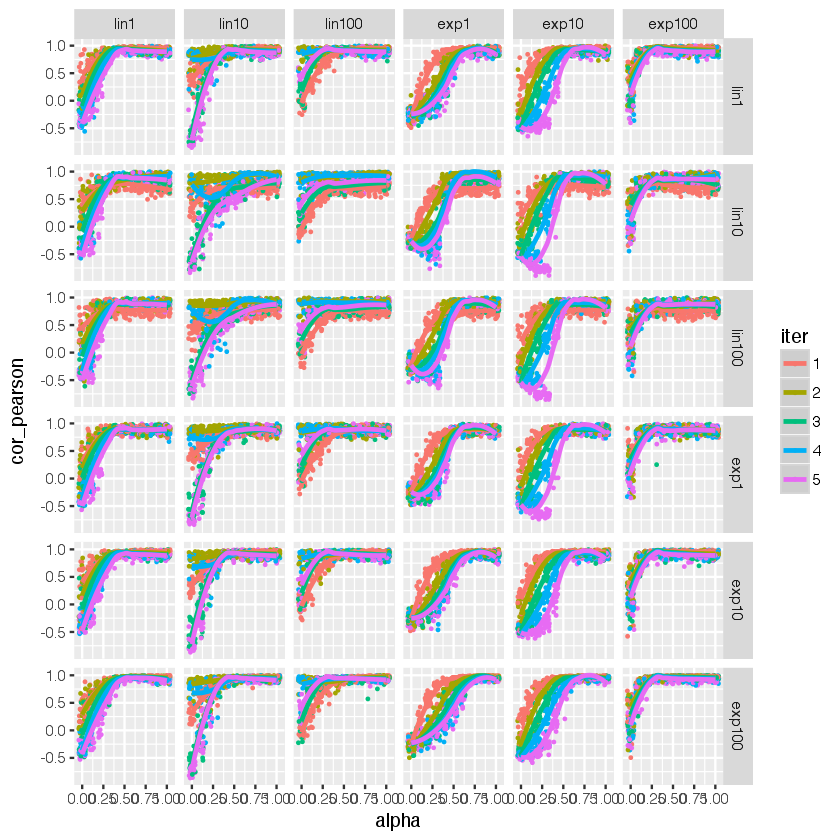

In [28]:
ggplot(data=na.omit(perf),aes(x=alpha,y=cor_pearson,color=iter)) + facet_grid(row_sim~col_sim) + geom_jitter(size=.3) + stat_smooth(aes(group=iter)) # + geom_point()  + stat_smooth() 
  # => t=2 is best


`geom_smooth()` using method = 'loess'


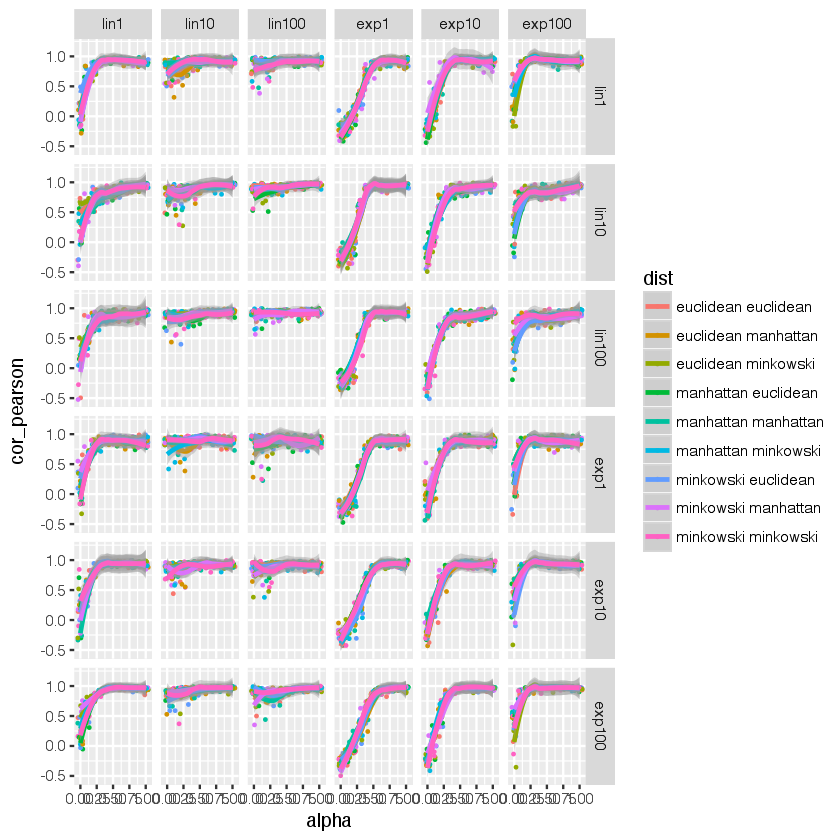

In [29]:
ggplot(data=na.omit(perf[perf$t==2,]),aes(x=alpha,y=cor_pearson,color=dist)) + facet_grid(row_sim~col_sim) + geom_jitter(size=.3) + stat_smooth(aes(group=dist)) # + geom_point()  + stat_smooth() 
  # => when t=2 performance is not sensitive to the distance function
  # alpha closer > .5 performs well. performance increases as alpha approaches 1
  # col_sim function (columns of figure) is more influencial than row_sim function
  # col_sim: lin100 > lin10 > lin1 > exp100 > exp10 > exp1 
  # row_sim: choice isn't essential, lin10 works

# Performance with n% missing data

In [30]:
t=c(1,2,3)
  alpha=seq(.4,1,.1)
  n=seq(.1,.9,.2)
  dist_m = c('euclidean','manhattan','binary','minkowski')[c(1,2)]
  sim = list(lin1=function(x) sim_linear_func(x,1),lin10=function(x) sim_linear_func(x,10),lin100=function(x) sim_linear_func(x,100),exp100=function(x) sim_exp_func(x,100) )
  par=expand.grid(t,alpha,dist_m,dist_m,names(sim),names(sim),n)
  colnames(par) = c('t','alpha','row_dist','col_dist','row_sim','col_sim','missing')
  X=mtcars
  nm=prod(dim(X))
  # basic parameter selection
  perf=data.frame(rbind(par,par),cor_pearson=apply(rbind(par,par),1,function(x) test_i(dat=X,t=as.numeric(x[1]),alpha=as.numeric(x[2]),di=dist(X,x[3]),dj=dist(t(X),x[4]),sim_i=sim[[x[5]]],sim_j=sim[[x[6]]],n=round(as.numeric(x[7])*nm) ) ))
  perf$dist = paste(perf$row_dist,perf$col_dist)
  perf$iter = factor(perf$t)
  perf$alpha_factor = factor(perf$alpha)
  perf$missing_factor = factor(perf$missing)

`geom_smooth()` using method = 'loess'


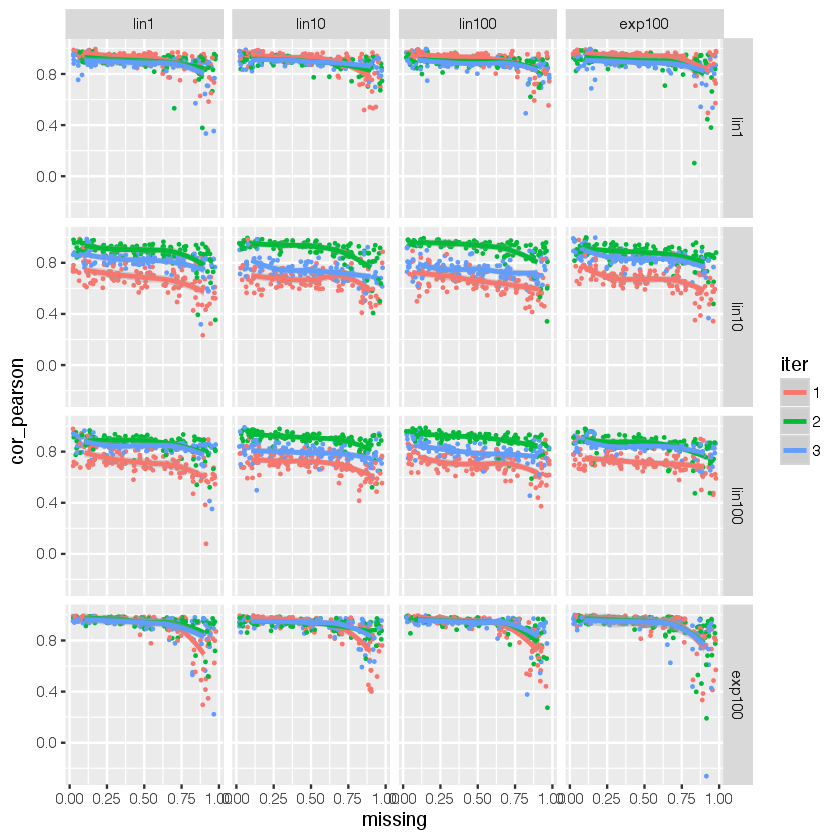

In [31]:
  ggplot(data=na.omit(perf[perf$alpha>=.7&perf$alpha<=.9,]),aes(x=missing,y=cor_pearson,color=iter)) + facet_grid(row_sim~col_sim) + geom_jitter(size=.3) + stat_smooth(aes(group=iter)) # + geom_point()  + stat_smooth() 
  # t=2 => best

`geom_smooth()` using method = 'loess'


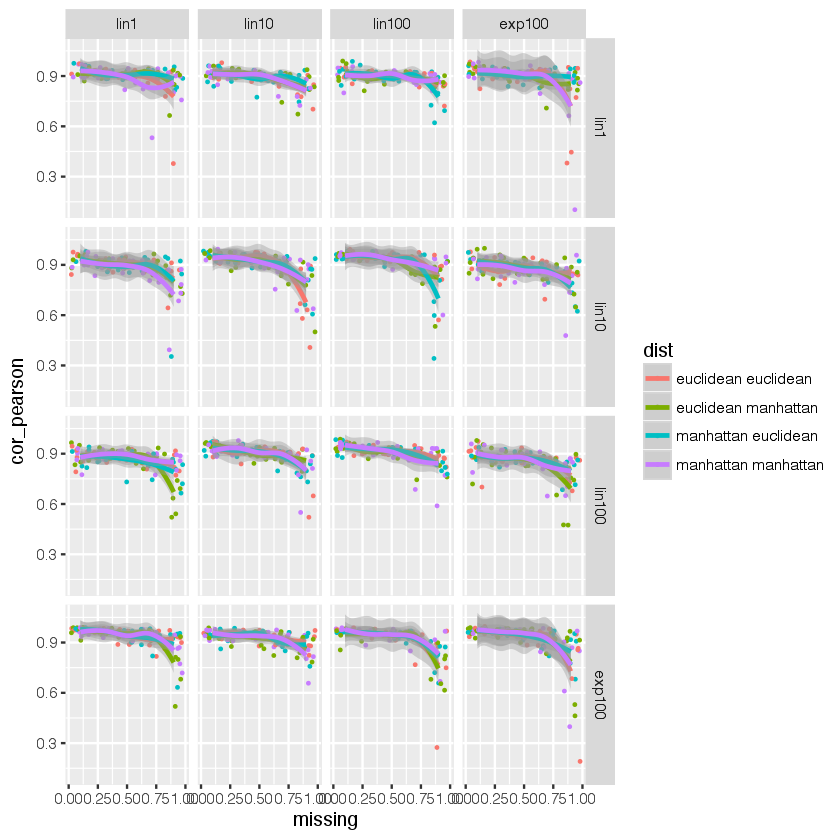

In [32]:
  ggplot(data=na.omit(perf[perf$t==2&perf$alpha>=.7&perf$alpha<=.9,]),aes(x=missing,y=cor_pearson,color=dist)) + facet_grid(row_sim~col_sim) + geom_jitter(size=.3) + stat_smooth(aes(group=dist)) # + geom_point()  + stat_smooth() 
  # dist => not very influenccial

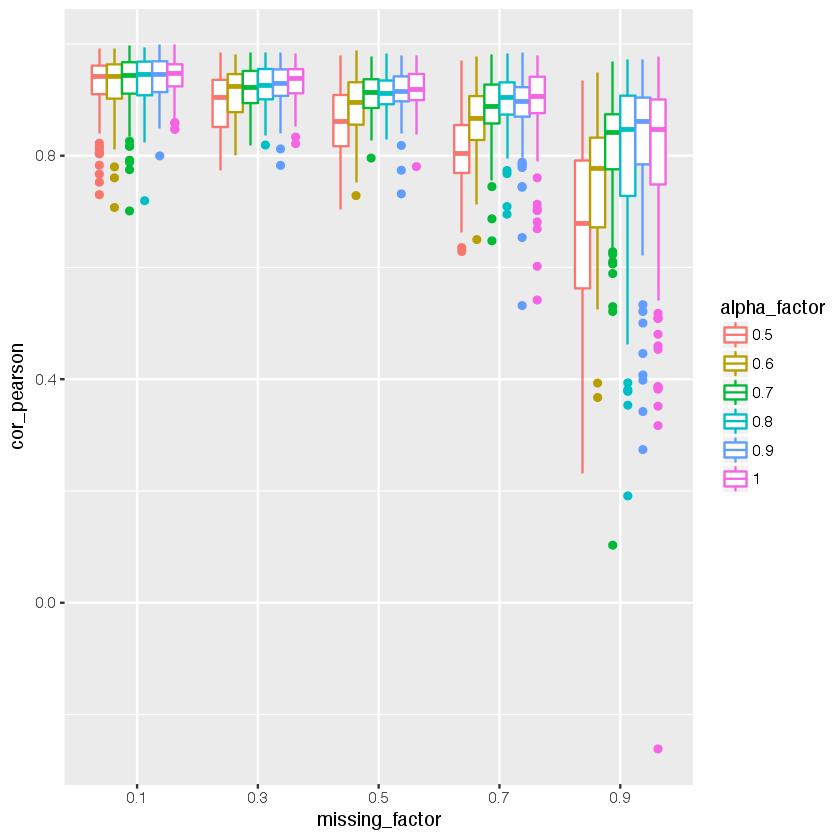

In [33]:
  #ggplot(data=na.omit(perf[perf$t==2&perf$alpha>=.5,]),aes(x=missing_factor,y=cor_pearson,color=alpha_factor))  +geom_boxplot()+ facet_grid(row_sim~col_sim)  #+ facet_grid(~alpha_factor,)  # + geom_point()  + stat_smooth() 
  ggplot(data=na.omit(perf[perf$t==2&perf$alpha>=.5,]),aes(x=missing_factor,y=cor_pearson,color=alpha_factor))  +geom_boxplot()
  # .7 < alpha < .8 is best for all proportions of missing data

# Benchmarking compare to nuclear norm and mean

In [34]:
 t=c(1,2,3)
  alpha=seq(.6,.9,.1)
  n=seq(.1,.9,.2)
  impute_methods=c('mean','nucnorm_svd','nucnorm_als','weightedMean') #[c(1,4)]
  dist_m = c('euclidean','manhattan','binary','minkowski')[c(1,2)]
  sim = list(lin1=function(x) sim_linear_func(x,1),lin10=function(x) sim_linear_func(x,10),lin100=function(x) sim_linear_func(x,100),exp100=function(x) sim_exp_func(x,100) )
  par=expand.grid(t,alpha,dist_m,dist_m,names(sim),names(sim),n,impute_methods)
  colnames(par) = c('t','alpha','row_dist','col_dist','row_sim','col_sim','missing','impute_method')
  X=mtcars
  nm=prod(dim(X))
  # basic parameter selection
  perf=data.frame(rbind(par,par),
                  cor=apply(rbind(par,par),1,function(x){
                    if(x[8]=='weightedMean'){
                      test_i(dat=X,t=as.numeric(x[1]),alpha=as.numeric(x[2]),
                             di=dist(X,x[3]),dj=dist(t(X),x[4]),
                             sim_i=sim[[x[5]]],sim_j=sim[[x[6]]],n=round(as.numeric(x[7])*nm) )
                    }else{
                      test_bench(dat=X,n=round(as.numeric(x[7])*nm) ,impute_method = x[8])
                    }} ))
  perf$dist = paste(perf$row_dist,perf$col_dist)
  perf$iter = factor(perf$t)
  perf$alpha_factor = factor(perf$alpha)
  perf$missing_factor = factor(perf$missing)

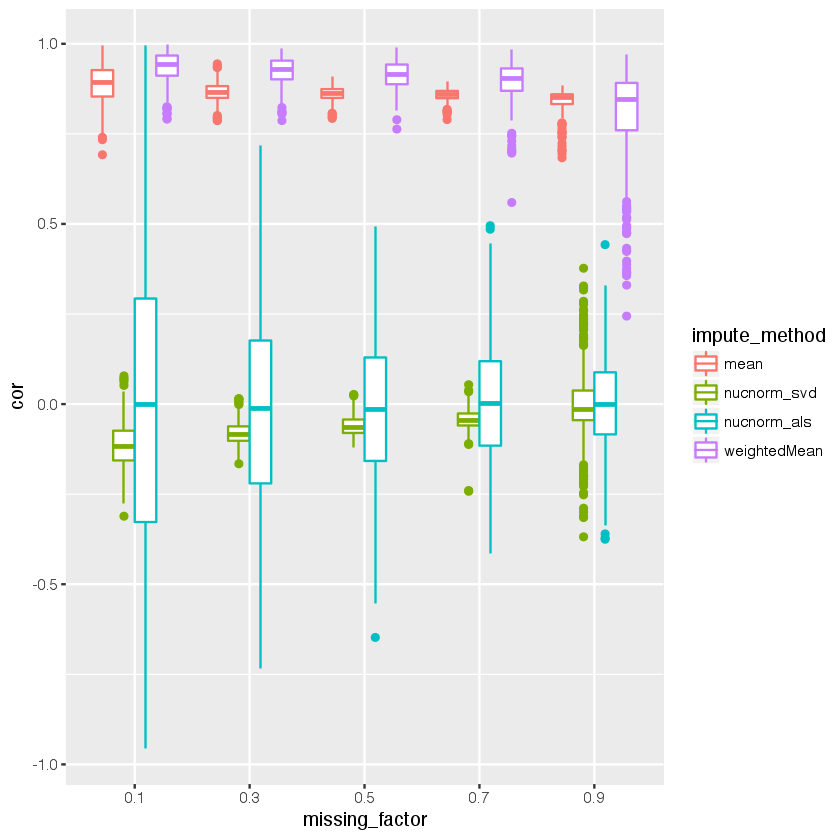

In [35]:

  #ggplot(data=na.omit(perf[perf$t==2&perf$alpha>=.7,]),aes(x=missing_factor,y=cor,color=impute_method))  +geom_boxplot()+ facet_grid(row_sim~col_sim)  #+ facet_grid(~alpha_factor,)  # + geom_point()  + stat_smooth() 
  ggplot(data=na.omit(perf[perf$t==2&perf$alpha>=.7,]),aes(x=missing_factor,y=cor,color=impute_method))  +geom_boxplot()  
  